In [3]:
from igraph import *
import igraph as ig
import json
import random
import numpy as np
import matplotlib.pyplot as plt

import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from matplotlib.patches import Circle

from itertools import combinations

from scipy.stats import f_oneway


random.seed(0)
np.random.seed(0)

#  ***Where-to-Meet***

You might have heard of When-to-Meet, an app that allows you to enter your time preferences and align when to meet your group or your friends. Now introducing *where-to-meet*, a way to meet your friends based on both time and distance. Let's say you live in Westwood, your friend Joe in WeHo, Gloria in the Fashion District, and Frank in Marina Del Rey. You want to meet for a beer, but don't want to make anyone schlep too much. So you try and find the point where everyone drives the same amount of time since we are good friends.
You could also try and minimze the total amount spent on the road for everyone but that is a bit less fair.

In [11]:

def load_data(filename='data/los_angeles_censustracts.json'):
    with open(filename) as f:
        census_areas = json.loads(f.readline())
    display_names = dict()
    coords = dict()

    for area in census_areas['features']:
        id = int(area['properties']['MOVEMENT_ID'])
        display_name = area['properties']['DISPLAY_NAME']
        display_names[id] = display_name
        a = area['geometry']['coordinates'][0]
        coords[id] = np.array(a if type(a[0][0]) == float else a[0]).mean(axis=0) 
    
    return display_names, coords, census_areas



def create_graph_from_month(month_filter, display_names, coords):
    edges = []
    weights = []

    G = Graph(directed=False)
    G.add_vertices(len(display_names))
    G.vs['display_name'] = list(display_names.values())
    G.vs['coords'] = list(coords.values())

    with open('/Users/ido_dukler/Documents/UCLAYear1/ECE232E/data-selected/los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv') as f:
        f.readline()  # skip the first line

        while True:
            line = f.readline()
            if line == '':
                break  # end of file
            
            vals = line.strip().split(',')
            
            # read edge info
            src, dest, month, dist = int(vals[0]), int(vals[1]), int(vals[2]), float(vals[3])
            
            # GLOBAL_EDGE_DICT[(src-1, dest-1)] (month, dist)
                    

            # only record in results in december
            if month == month_filter:
                edges.append((src - 1, dest - 1))
                weights.append(dist)


    G.add_edges(edges)
    G.es['weight'] = weights
    del edges, weights

    # keep only the giant connected component
    components = G.components()
    gcc = max(components, key=len)
    vs_to_delete = [i for i in range(len(G.vs)) if i not in gcc]
    G.delete_vertices(vs_to_delete)

    # remove duplicate edges
    G_SIMPLE = G.copy()
    G_SIMPLE = G_SIMPLE.simplify(combine_edges=dict(weight='mean'))  # combine duplicate edges by avergaing

    print("Month: ", month_filter)
    print("number of vertices: " + str(len(G.vs)))
    print("number of edges: " + str(len(G.es)))
    print("number of simplified edges: " + str(len(G_SIMPLE.es)))
    
    return G, G_SIMPLE

# Visualizing friends on graph 

Here I created the graphs and visualizing the group of friends on the graph. A centroid of the middle between all friends is added a heuristic of where the physical meeting point would be. This will later be used with an additional heuristic of the radius of the graph for finding the best place to meet. Note -- I use a version of the graph where multi-edges are averaged. For October, there were no more than two of the same trip.

In [5]:
# Step 0 -- load data
display_names, coords, census_areas = load_data()

# Step 1 -- generate graph

G_10, G_10_SIMPLE = create_graph_from_month(10, display_names, coords)
G_11, G_11_SIMPLE = create_graph_from_month(11, display_names, coords)
G_12, G_12_SIMPLE = create_graph_from_month(12, display_names, coords)

Month:  10
number of vertices: 2652
number of edges: 1780452
number of simplified edges: 1052236
Month:  11
number of vertices: 2651
number of edges: 1671160
number of simplified edges: 991353
Month:  12
number of vertices: 2649
number of edges: 1692450
number of simplified edges: 1003858


In [6]:
def find_vertex_from_loc(location, coords):

    min_distance=np.inf
    closest_node=0
    for i in range(1,len(coords)):
        closest=np.sqrt(((coords[i][0])-location[0])**2+((coords[i][1])-location[1])**2)
        if closest<min_distance:
            min_distance=closest
            closest_node=i
     

    print(f"Closest node to {location}: {closest_node}")
    
    return closest_node

def get_centroid(group_loc_list_np):
    centroid = [group_loc_list_np[:,0].mean(), group_loc_list_np[:,1].mean()]
    return centroid

In [7]:
weho = [-118.369071, 34.087225]
fasion_distict = [-118.246831, 34.034610]
marina_del_rey = [-118.429260, 33.992369]
ucla = [-118.444215, 34.069847]


group_loc_list = [weho, fasion_distict, marina_del_rey, ucla]
group_loc_list_np = np.array(group_loc_list)



centroid = get_centroid(group_loc_list_np)

G_10_coords = G_10.vs["coords"]
centroid_node = find_vertex_from_loc(centroid, G_10_coords)
print(f"Centroid node: {centroid_node}")



friend_nodes = {str(loc): find_vertex_from_loc(loc, G_10_coords) for loc in group_loc_list}


Closest node to [np.float64(-118.37234425), np.float64(34.04601275)]: 1316
Centroid node: 1316
Closest node to [-118.369071, 34.087225]: 1136
Closest node to [-118.246831, 34.03461]: 1378
Closest node to [-118.42926, 33.992369]: 250
Closest node to [-118.444215, 34.069847]: 1523


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

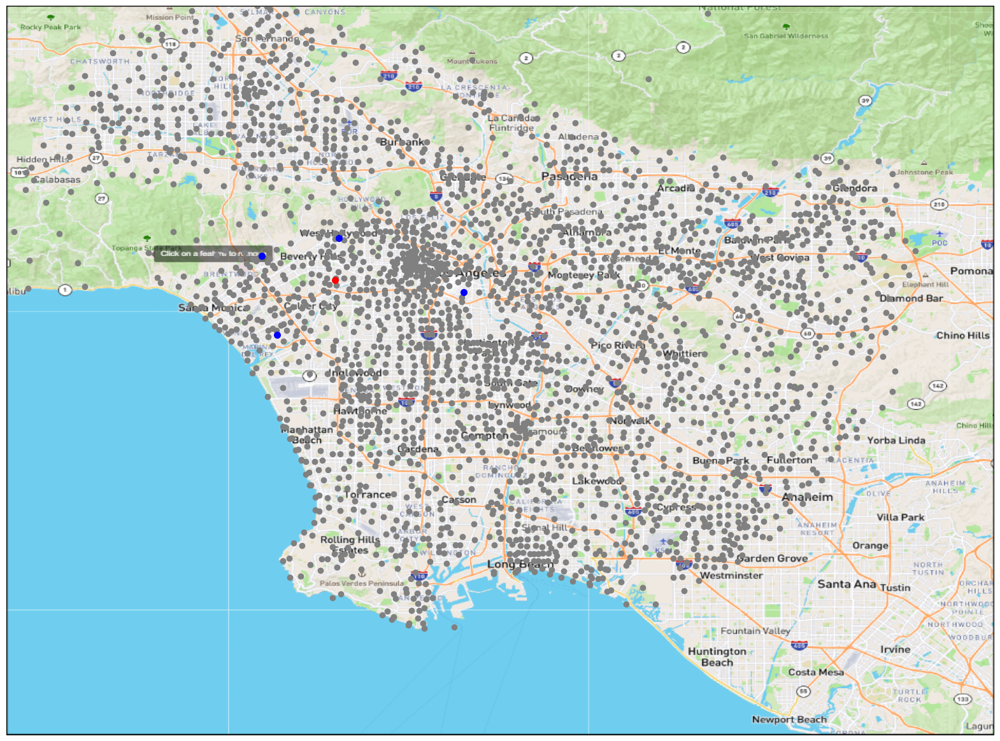

In [9]:
# Where you and your friends are on the map
plt.clf()  # Clear everything
plt.figure()

coords_values = coords.values()
coords_values = np.array(list(coords_values))


group_loc_list_np = group_loc_list_np[:, [1, 0]]  # [lon, lat]

# Bounding box: (lon_min, lon_max, lat_min, lat_max)
Bounding = (-118.693542, -117.729492, 33.602038, 34.313950)

# Plot
fig = plt.figure(figsize=(20, 20))
ax = plt.axes(projection=ccrs.PlateCarree())

# Plot the path
ax.plot(coords_values[:,0], coords_values[:,1], 'o', color='gray')
ax.plot(group_loc_list_np[:, 0], group_loc_list_np[:, 1], 'o', color='blue', markersize=7, zorder=4)
ax.plot(centroid[0], centroid[1], 'o', color='red', markersize=7, linewidth=10, zorder=2)

# Add background map
LA_map_img = plt.imread('data/LA_Map.png')
ax.imshow(LA_map_img, zorder=0, extent=Bounding, aspect='equal')

ax.set_extent([centroid[0]-0.2, centroid[0]+0.2, centroid[1]-0.2, centroid[1]+0.2], crs=ccrs.PlateCarree())

# Set extent to bounding box
ax.set_xlim(Bounding[0], Bounding[1])
ax.set_ylim(Bounding[2], Bounding[3])

plt.draw()
plt.pause(0.001) 
plt.show()

In [10]:

def max_diameter(group_loc_list):
    
    pairs = list(combinations(group_loc_list, 2))
        

    max_distance = 0

    for pair in pairs:
        
        loc1, loc2 = pair
        distance = np.sqrt(((loc1[0])-loc2[0])**2 + ((loc1[1])-loc2[1])**2)
        
        if distance >= max_distance:
            max_distance = distance
            
    print(f"Max diameter (degrees): {max_distance} miles: {max_distance*69}")
    
    return max_distance


max_diam = max_diameter(group_loc_list)

Max diameter (degrees): 0.20050458754103354 miles: 13.834816540331314


# Searching for the best meeting point

Now that I have the centroid and friends on the graph we can use the max radius between the furthest friends (half their max diameter) to have a smaller search space for finding the best spot to meet.

In [16]:
# given the centroid and the max diameter -> find the nodes within the max diameter as it probs wont include anything else (can go a little harsher and go within 1-10 miles of centroid)

def induced_graph_by_radius(g, centroid, radius): 
    
    print("max diam:", radius * 2)
    
    nodes_to_delete = []
    

    for vs in g.vs:
        curr_coords = vs["coords"]
    
        dist_from_centroid = ((curr_coords[0])-centroid[0])**2 + ((curr_coords[1])-centroid[1])**2
        if dist_from_centroid >= radius**2:
            nodes_to_delete.append(vs.index)
            
    g_copy = g.copy()
    
    g_copy.delete_vertices(nodes_to_delete)
    
    return g_copy


G_10_reduced = induced_graph_by_radius(G_10_SIMPLE, centroid, max_diam/2)
coords_reduced = G_10_reduced.vs["coords"]
coords_reduced = np.array(coords_reduced)

max diam: 0.20050458754103354


# Our algorithm

In [ ]:
def find_minimax_time_centroid(g, search_nodes, friend_nodes):
    
    all_times = {}
    
    print(f"Started search")
    for possible_meeting in search_nodes:
    
        all_times_per_node = []
        
        for friend in friend_nodes:

            shortest_path = g.get_shortest_paths(friend_nodes[friend], possible_meeting, weights="weight", output="epath")
            
            time_to_meeting = 0
            for e in shortest_path[0]:
                time_to_meeting += g.es[e]["weight"]
                            
            
            all_times_per_node.append(time_to_meeting)
            
        all_times[possible_meeting] = all_times_per_node 
    
    print(f"Done.")
    
    # find the minimax meeting point
    max_times = [(possible_meeting, max(all_times_per_node))  for (possible_meeting, all_times_per_node) in all_times.items()] # max
    best_meeting =  min(max_times, key=lambda node_time: node_time[1]) # min
    print(f"Best meeting time and point: {best_meeting}")

    meeting_index, max_meeting_time = best_meeting
    

        
    
    return meeting_index, all_times, max_times
        
    
    
G_10_reduced_coords = G_10_reduced.vs["coords"]
friend_nodes = {str(loc): find_vertex_from_loc(loc,G_10_reduced_coords) for loc in group_loc_list} # indices change to need to re-run
    
best_meeting_index, all_times, max_times = find_minimax_time_centroid(G_10_reduced, list(G_10_reduced.vs.indices), friend_nodes)
        

Closest node to [-118.369071, 34.087225]: 99
Closest node to [-118.246831, 34.03461]: 118
Closest node to [-118.42926, 33.992369]: 14
Closest node to [-118.444215, 34.069847]: 290
Started search
Done.
Best meeting time and point: (314, 891.27)


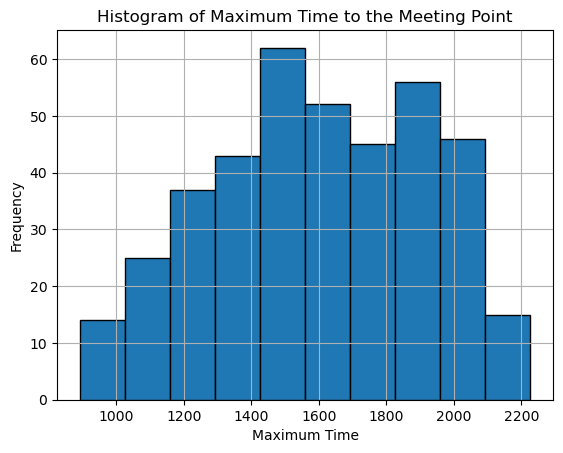

In [18]:
# Showing max_times distributions

max_times_only = [max_time for index, max_time in max_times]

plt.hist(max_times_only, bins=10, edgecolor='black')
plt.title("Histogram of Maximum Time to the Meeting Point")
plt.xlabel("Maximum Time")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

# Now lets put it all in one cell, run and visualize *where-to-meet*!

In [ ]:

# You, your friends and your locations
weho = [-118.369071, 34.087225]
fasion_distict = [-118.246831, 34.034610]
marina_del_rey = [-118.429260, 33.992369]
ucla = [-118.444215, 34.069847]
# Put in a list
group_loc_list = [weho, fasion_distict, marina_del_rey, ucla]
group_loc_list_np = np.array(group_loc_list)

# Getting the physical centroid of you and your friends 
centroid = get_centroid(group_loc_list_np)
max_diam = max_diameter(group_loc_list)

# Create a smaller graph based on the max_radius and the centroid as heuristics
# (i.e. that the location won't lie outside of this circle but it could if all paths are shorter to there)
G_10_reduced = induced_graph_by_radius(G_10, centroid, max_diam/2)
coords_reduced = G_10_reduced.vs["coords"]
coords_reduced = np.array(coords_reduced)


# Run the algorithm to see where to meet
G_10_reduced_coords = G_10_reduced.vs["coords"]
friend_nodes = {str(loc): find_vertex_from_loc(loc,G_10_reduced_coords) for loc in group_loc_list} # indices change to need to re-run
    
best_meeting_index, all_times, max_times = find_minimax_time_centroid(G_10_reduced, list(G_10_reduced.vs.indices), friend_nodes)

Max diameter (degrees): 0.20050458754103354 miles: 13.834816540331314
max diam: 0.20050458754103354
Closest node to [-118.369071, 34.087225]: 99
Closest node to [-118.246831, 34.03461]: 118
Closest node to [-118.42926, 33.992369]: 14
Closest node to [-118.444215, 34.069847]: 290
Started search
Done.
Best meeting time and point: (314, 826.79)


<Figure size 640x480 with 0 Axes>

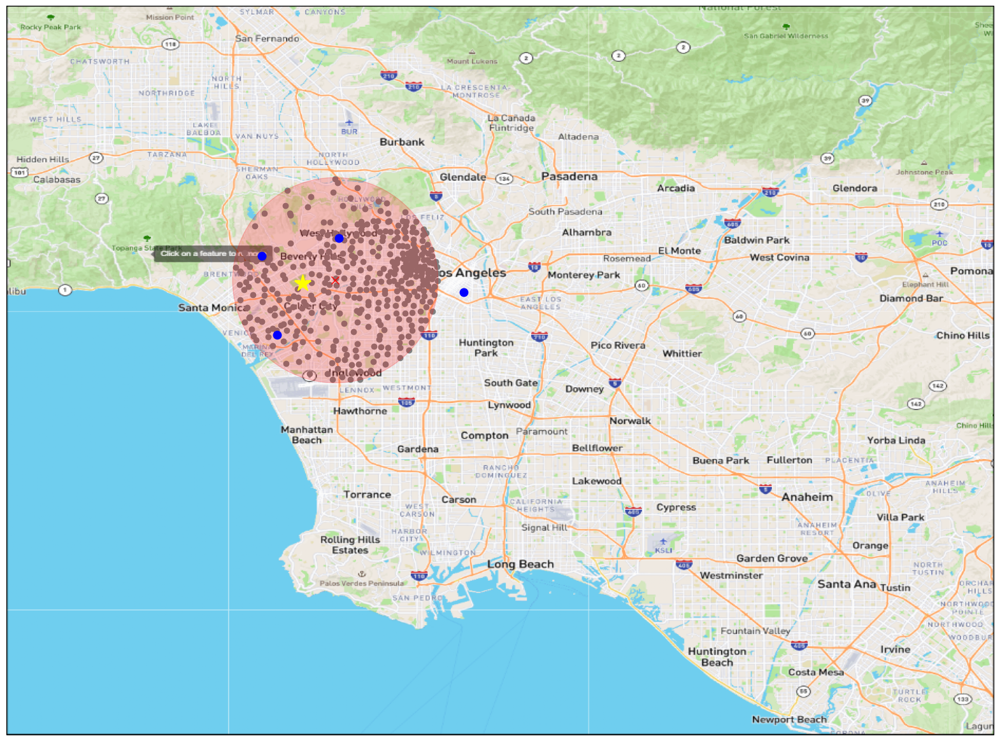

In [20]:
def plot_meeting_point(group_loc_list_np, coords_reduced, centroid, meeting_location, max_diam):
    plt.clf()

    # Bounding box: (lon_min, lon_max, lat_min, lat_max)
    Bounding = (-118.693542, -117.729492, 33.602038, 34.313950)

    # Plot
    fig = plt.figure(figsize=(20, 20))
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Add background map
    LA_map_img = plt.imread('data/LA_Map.png')
    # ax.imshow(LA_map_img, zorder=0, extent=Bounding, aspect='equal')
    ax.imshow(LA_map_img, zorder=0, extent=Bounding, transform=ccrs.PlateCarree(), aspect='equal')

    # Plot the path
    ax.plot(coords_reduced[:,0], coords_reduced[:,1], 'o', color='gray', zorder=1)
    ax.plot(centroid[0], centroid[1], 'x', color='red', markersize=8, zorder=3)
    ax.plot(group_loc_list_np[:, 0], group_loc_list_np[:, 1], 'o', color='blue', markersize=9, zorder=4)

    # print(group_loc_list_np[:, 0])

    # Plot meeting point
    ax.plot(meeting_location[0], meeting_location[1], marker='*', markersize=20, color='yellow', zorder=5)

    # Add circle 
    radius_deg = max_diam / 2

    # Create a circle patch in lon/lat coords
    # print(centroid)
    circle = Circle((centroid[0], centroid[1]), radius_deg, color='red', alpha=0.2, transform=ccrs.PlateCarree(), zorder=2)

    ax.add_patch(circle)

    ax.set_extent([centroid[0]-0.2, centroid[0]+0.2, centroid[1]-0.2, centroid[1]+0.2], crs=ccrs.PlateCarree())

    # Set extent to bounding box
    ax.set_xlim(Bounding[0], Bounding[1])
    ax.set_ylim(Bounding[2], Bounding[3])

    # Your plotting code here
    plt.draw()
    plt.pause(0.001)  # Small pause to let the backend catch up
    plt.show()
    
# Plot the meeting point
meeting_location = G_10_reduced.vs[best_meeting_index]["coords"]
plot_meeting_point(group_loc_list_np, coords_reduced, centroid, meeting_location, max_diam)


## Result of our algorithm...

Now we can know *where-to-meet*! Our rule of thumb is to use half the maximum distance between the furthest two points within the group as the radius of the circle from the centroid. This allows us to run minimax and find the best possible spot to meet within the circle. This gives us an approximate algorithm for finding the best place to meet based on time. 

This algorithm is good for this case within LA, but doesn't scale well for really large distances apart that contain many potential meeting points. Even within LA this doesn't scale to if the centroid is in the middle of LA and the radius covers from Calabasas to Irvine with every possible node in the graph needing to search ```| friends |``` amount of times over the whole graph.

# Does the meeting point change for different times of the year?

Let's test it out.

In [112]:
### putting it all in one cell

# You, your friends and your locations
weho = [-118.369071, 34.087225]
fasion_distict = [-118.246831, 34.034610]
marina_del_rey = [-118.429260, 33.992369]
ucla = [-118.444215, 34.069847]
# Put in a list
group_loc_list = [weho, fasion_distict, marina_del_rey, ucla]
group_loc_list_np = np.array(group_loc_list)

max_diam = max_diameter(group_loc_list)
centroid = get_centroid(group_loc_list_np)


def find_meeting_point(g, group_loc_list, max_diam, centroid):
    
    # Create a smaller graph based on the max_radius and the centroid as heuristics
    # (i.e. that the location won't lie outside of this circle but it could if all paths are shorter to there)
    G_reduced = induced_graph_by_radius(g, centroid, max_diam/2)
    coords_reduced = G_reduced.vs["coords"]
    coords_reduced = np.array(coords_reduced)


    # Run the algorithm to see where to meet
    G_reduced_coords = G_reduced.vs["coords"]
    friend_nodes = {str(loc): find_vertex_from_loc(loc,G_reduced_coords) for loc in group_loc_list} # indices change to need to re-run
        
    best_meeting_index, all_times, max_times = find_minimax_time_centroid(G_reduced, list(G_reduced.vs.indices), friend_nodes)
    
    best_meeting_location = [G_reduced.vs[best_meeting_index]["coords"][0], G_reduced.vs[best_meeting_index]["coords"][1]]
    
    return best_meeting_index, best_meeting_location, all_times, max_times, coords_reduced

# best_meeting_index, best_meeting_location, all_times, max_times = find_meeting_point(G_10)

Max diameter (degrees): 0.20050458754103354 miles: 13.834816540331314


In [117]:
best_10 = find_meeting_point(G_10, group_loc_list, max_diam, centroid)
best_11 = find_meeting_point(G_11, group_loc_list, max_diam, centroid)
best_12 = find_meeting_point(G_12, group_loc_list, max_diam, centroid)

max diam: 0.20050458754103354
Closest node to [-118.369071, 34.087225]: 99
Closest node to [-118.246831, 34.03461]: 118
Closest node to [-118.42926, 33.992369]: 14
Closest node to [-118.444215, 34.069847]: 290
Started search
Done.
Best meeting time and point: (314, 826.79)
max diam: 0.20050458754103354
Closest node to [-118.369071, 34.087225]: 99
Closest node to [-118.246831, 34.03461]: 118
Closest node to [-118.42926, 33.992369]: 14
Closest node to [-118.444215, 34.069847]: 290
Started search
Done.
Best meeting time and point: (314, 814.1600000000001)
max diam: 0.20050458754103354
Closest node to [-118.369071, 34.087225]: 99
Closest node to [-118.246831, 34.03461]: 118
Closest node to [-118.42926, 33.992369]: 14
Closest node to [-118.444215, 34.069847]: 290
Started search
Done.
Best meeting time and point: (329, 769.5999999999999)


Best meeting point for month 10: [np.float64(-118.40409189041102), np.float64(34.042864689497726)] with index 314


<Figure size 640x480 with 0 Axes>

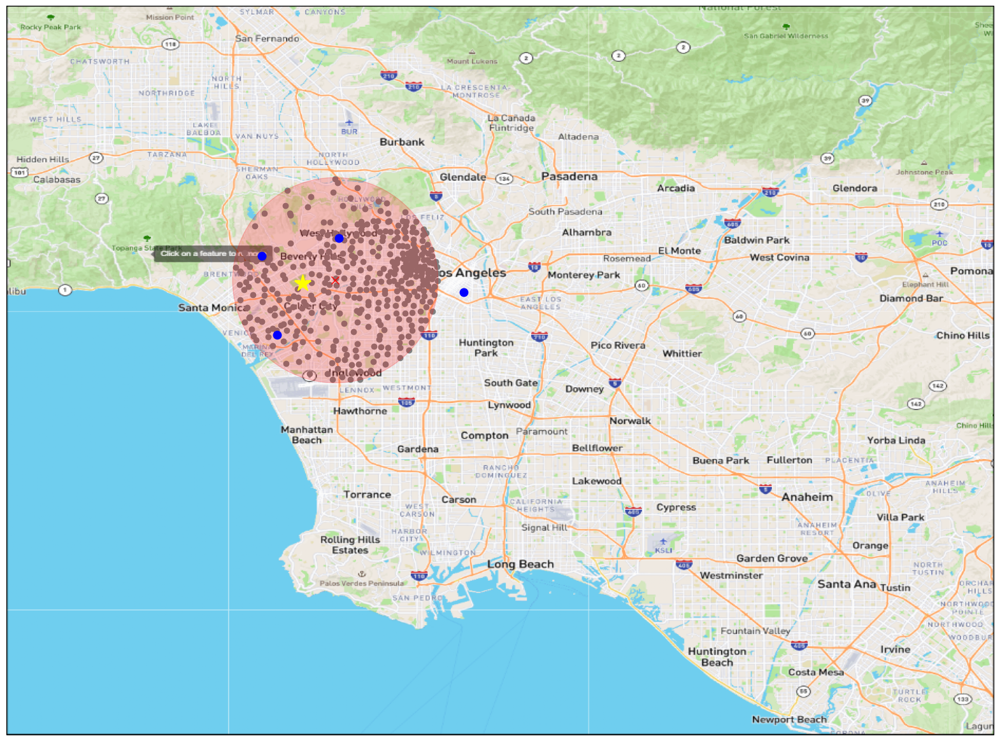

In [118]:
best_meeting_index, best_meeting_location, all_times, max_times, coords_reduced = best_10 
print(f"Best meeting point for month 10: {best_meeting_location} with index {best_meeting_index}")
plot_meeting_point(group_loc_list_np, coords_reduced, centroid, best_meeting_location, max_diam)

Best meeting point for month 11: [np.float64(-118.40409189041102), np.float64(34.042864689497726)] with index 314


<Figure size 640x480 with 0 Axes>

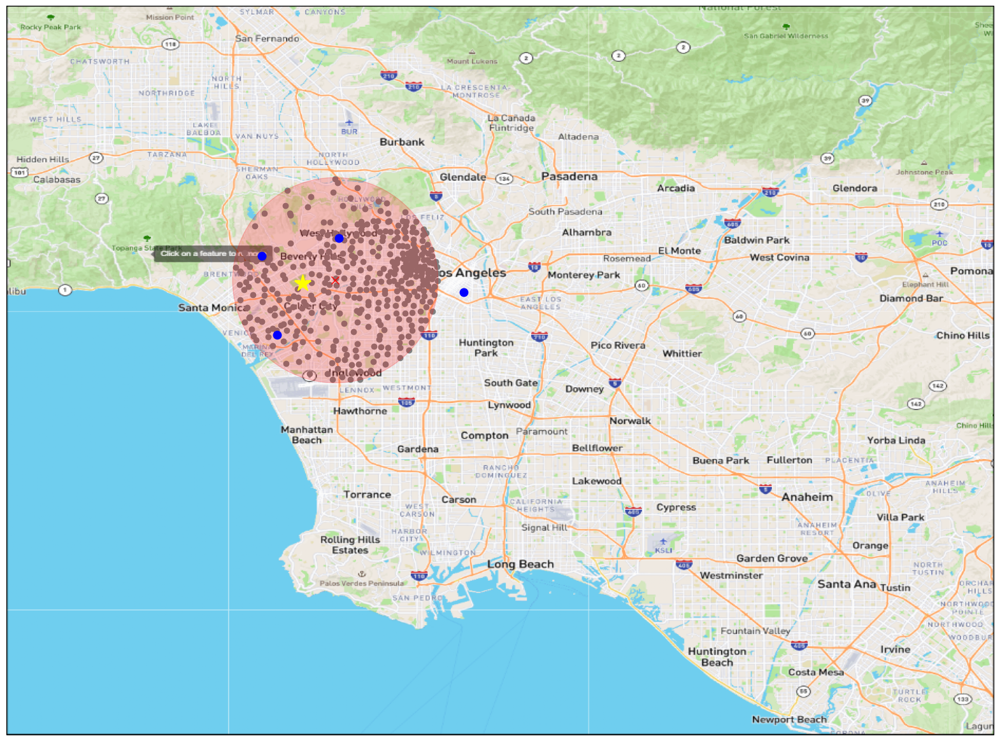

In [119]:
best_meeting_index, best_meeting_location, all_times, max_times, coords_reduced = best_11
print(f"Best meeting point for month 11: {best_meeting_location} with index {best_meeting_index}")
plot_meeting_point(group_loc_list_np, coords_reduced, centroid, best_meeting_location, max_diam)

Best meeting point for month 12: [np.float64(-118.37161782222225), np.float64(34.041084177777776)] with index 329


<Figure size 640x480 with 0 Axes>

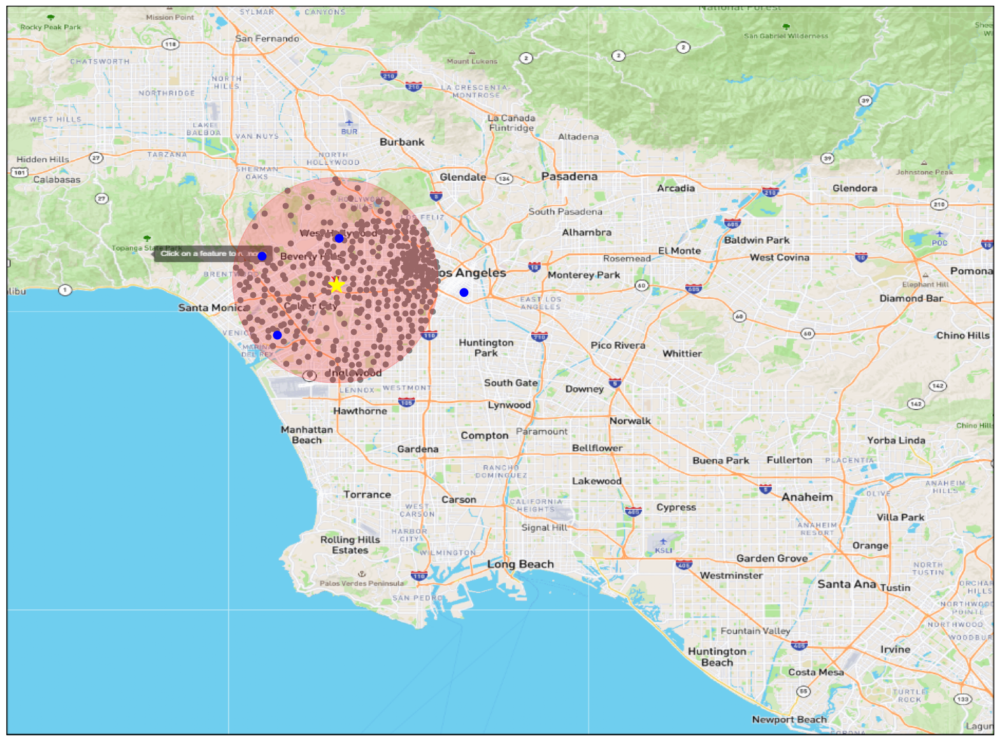

In [120]:
best_meeting_index, best_meeting_location, all_times, max_times, coords_reduced = best_12
print(f"Best meeting point for month 12: {best_meeting_location} with index {best_meeting_index}")
plot_meeting_point(group_loc_list_np, coords_reduced, centroid, best_meeting_location, max_diam)

## Results over time:
From these visualizations, we can see that October and November had the same meeting point and almost exactly the same time (~13 minutes) but that December had a different meeting point and a time of 45sec-1min faster than the previous two months. This could be due to holiday season with more people out of town or maybe a change in the road.


Let's test this for a new friend group configurations.

In [128]:
# You, your friends and your locations
# We can add more locations here
downey = [-118.163983, 33.925608]
inglewood = [-118.363072, 33.972258]
los_feliz = [-118.292946, 34.103123]
playa_vista = [-118.408664, 33.984829]

group_loc_list = [fasion_distict, marina_del_rey, ucla, downey, inglewood, los_feliz, playa_vista]
group_loc_list_np = np.array(group_loc_list)

max_diam = max_diameter(group_loc_list)
centroid = get_centroid(group_loc_list_np)


Max diameter (degrees): 0.3151743373832975 miles: 21.747029279447524


max diam: 0.3151743373832975
Closest node to [-118.246831, 34.03461]: 486
Closest node to [-118.42926, 33.992369]: 39
Closest node to [-118.444215, 34.069847]: 620
Closest node to [-118.163983, 33.925608]: 779
Closest node to [-118.363072, 33.972258]: 140
Closest node to [-118.292946, 34.103123]: 198
Closest node to [-118.408664, 33.984829]: 803
Started search
Done.
Best meeting time and point: (480, 1444.1549999999997)


<Figure size 640x480 with 0 Axes>

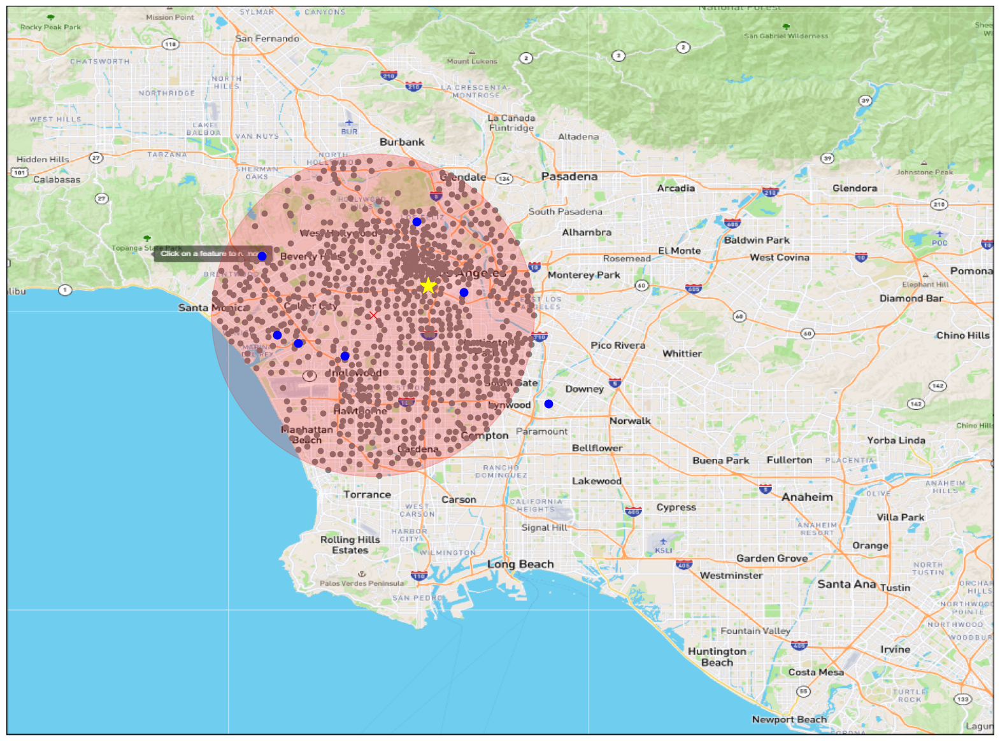

In [129]:
best_10 = find_meeting_point(G_10_SIMPLE, group_loc_list, max_diam, centroid)
best_meeting_index, best_meeting_location, all_times, max_times, coords_reduced = best_10
plot_meeting_point(group_loc_list_np, coords_reduced, centroid, best_meeting_location, max_diam)

max diam: 0.3151743373832975
Closest node to [-118.246831, 34.03461]: 486
Closest node to [-118.42926, 33.992369]: 39
Closest node to [-118.444215, 34.069847]: 620
Closest node to [-118.163983, 33.925608]: 779
Closest node to [-118.363072, 33.972258]: 140
Closest node to [-118.292946, 34.103123]: 198
Closest node to [-118.408664, 33.984829]: 803
Started search
Done.
Best meeting time and point: (480, 1403.355)


<Figure size 640x480 with 0 Axes>

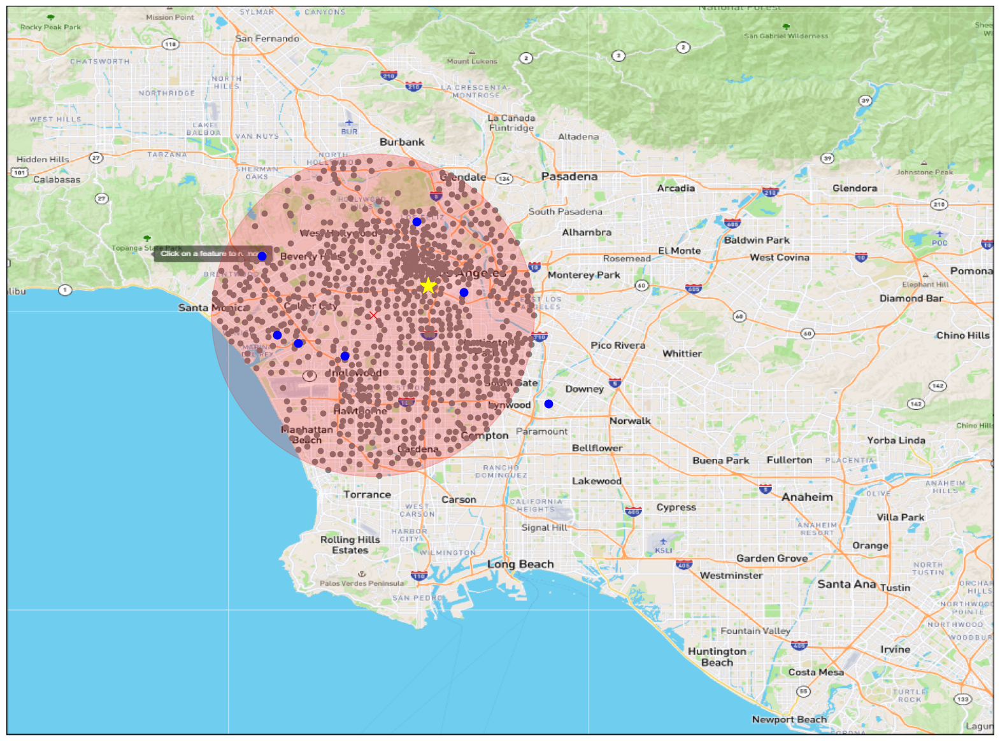

In [127]:
best_11 = find_meeting_point(G_11_SIMPLE, group_loc_list, max_diam, centroid)
best_meeting_index, best_meeting_location, all_times, max_times, coords_reduced = best_11
plot_meeting_point(group_loc_list_np, coords_reduced, centroid, best_meeting_location, max_diam)

max diam: 0.3151743373832975
Closest node to [-118.246831, 34.03461]: 486
Closest node to [-118.42926, 33.992369]: 39
Closest node to [-118.444215, 34.069847]: 620
Closest node to [-118.163983, 33.925608]: 779
Closest node to [-118.363072, 33.972258]: 140
Closest node to [-118.292946, 34.103123]: 198
Closest node to [-118.408664, 33.984829]: 802
Started search
Done.
Best meeting time and point: (480, 1355.12)


<Figure size 640x480 with 0 Axes>

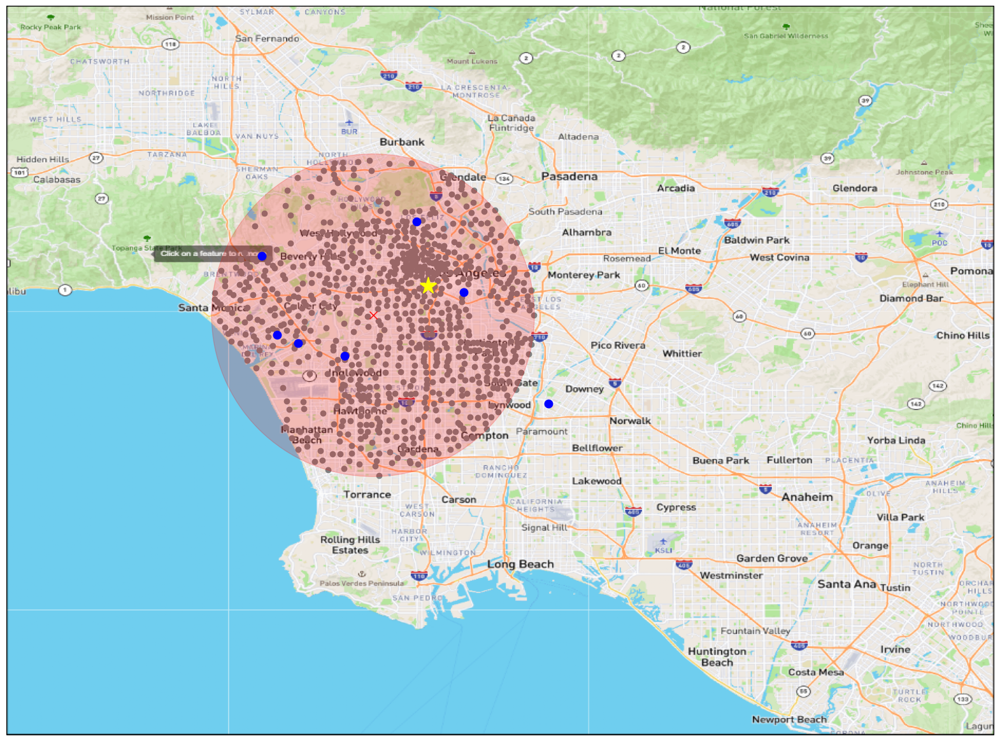

In [126]:
best_12 = find_meeting_point(G_12_SIMPLE, group_loc_list, max_diam, centroid)
best_meeting_index, best_meeting_location, all_times, max_times, coords_reduced = best_12
plot_meeting_point(group_loc_list_np, coords_reduced, centroid, best_meeting_location, max_diam)

The same meeting point was chosen for these months with about a time change of 45 second decrease between October -> November -> December. In order to get a better grasp of the changes, the distribution of the times of each month are analyzed below. 

Comparing October vs November:


/var/folders/55/2m39_14s05xc9ckrt1xdhh940000gn/T/ipykernel_98098/443783656.py:32: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


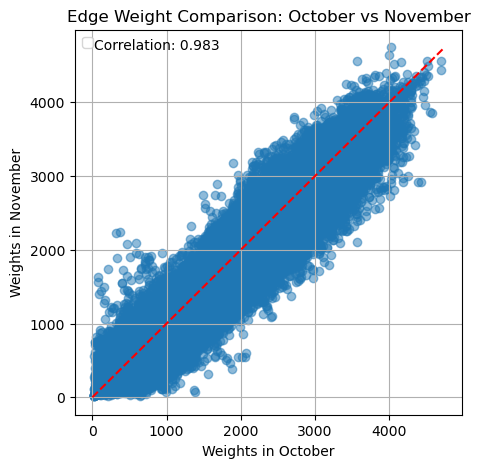

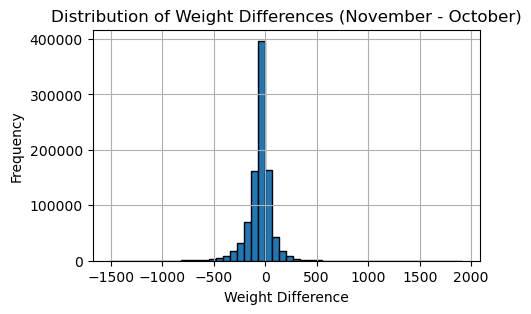

Mean difference: -49.966
Std difference: 118.734
Comparing November vs December:


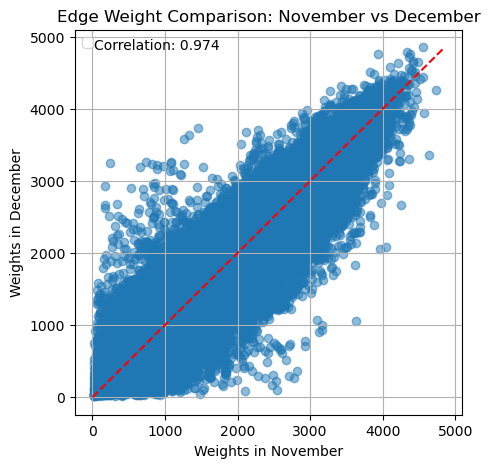

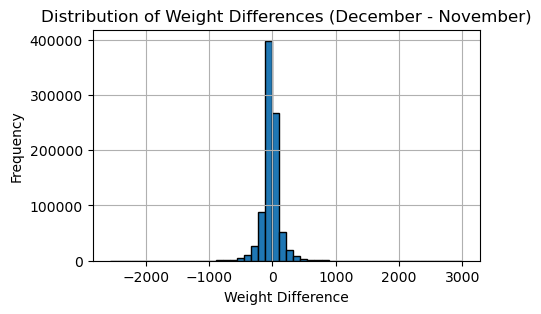

Mean difference: -23.219
Std difference: 142.374
Comparing October vs December:


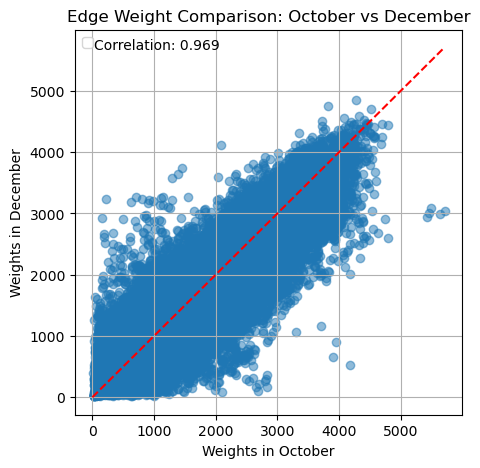

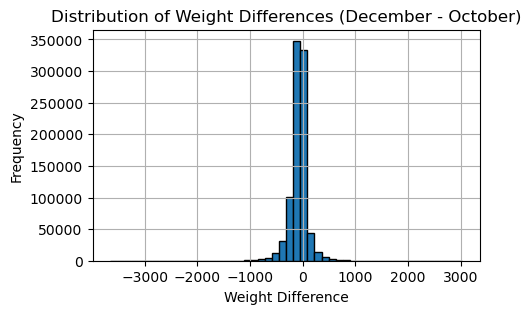

Mean difference: -75.418
Std difference: 161.569


In [22]:
def compare_graph_weights(g1, g2, month1, month2):
    edge_weights1 = {(e.source, e.target): e["weight"] for e in g1.es}
    edge_weights2 = {(e.source, e.target): e["weight"] for e in g2.es}
    
    common_edges = set(edge_weights1.keys()) & set(edge_weights2.keys())
        
    # print(common_edges)
    
    weights1 = []
    weights2 = []
    
    for edge in common_edges:
        weights1.append(edge_weights1[edge])
        weights2.append(edge_weights2[edge])
    
    weights1 = np.array(weights1)
    weights2 = np.array(weights2)
    
    weight_diffs = weights2 - weights1
    
    ################################
    # Plotting the weights comparison
    plt.figure(figsize=(5, 5))
    plt.scatter(weights1, weights2, alpha=0.5)
    plt.plot([0, max(max(weights1), max(weights2))], 
             [0, max(max(weights1), max(weights2))], 
             'r--')
    
    plt.xlabel(f'Weights in {month1}')
    plt.ylabel(f'Weights in {month2}')
    plt.title(f'Edge Weight Comparison: {month1} vs {month2}')
    plt.legend()
    
    corr = np.corrcoef(weights1, weights2)[0,1]
    plt.text(0.05, 0.95, f'Correlation: {corr:.3f}', 
             transform=plt.gca().transAxes)
    
    plt.grid(True)
    plt.show()
    
    plt.figure(figsize=(5, 3))
    plt.hist(weight_diffs, bins=50, edgecolor='black')
    plt.title(f'Distribution of Weight Differences ({month2} - {month1})')
    plt.xlabel('Weight Difference')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()
    
    return np.mean(weight_diffs), np.std(weight_diffs), corr

# Compare all pairs of months
print("Comparing October vs November:")
mean_diff_10_11, std_diff_10_11, corr_10_11 = compare_graph_weights(G_10_SIMPLE, G_11_SIMPLE, "October", "November")
print(f"Mean difference: {mean_diff_10_11:.3f}")
print(f"Std difference: {std_diff_10_11:.3f}")

print("Comparing November vs December:")
mean_diff_11_12, std_diff_11_12, corr_11_12 = compare_graph_weights(G_11_SIMPLE, G_12_SIMPLE, "November", "December")
print(f"Mean difference: {mean_diff_11_12:.3f}")
print(f"Std difference: {std_diff_11_12:.3f}")

print("Comparing October vs December:")
mean_diff_10_12, std_diff_10_12, corr_10_12 = compare_graph_weights(G_10_SIMPLE, G_12_SIMPLE, "October", "December")
print(f"Mean difference: {mean_diff_10_12:.3f}")
print(f"Std difference: {std_diff_10_12:.3f}")

From these results, we see that there is no big difference between the weights across different months with a correlation coefficient of almost 1 for all months. This indicates that the distribution of the changes over the same trip times across different months stays about the same. The same is true for the mean differences. To be sure we can re-run this analysis with a one-way ANOVA test over each of the average trip times in order to check for any dramatic changes in the trip times.

/var/folders/55/2m39_14s05xc9ckrt1xdhh940000gn/T/ipykernel_98098/252720981.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


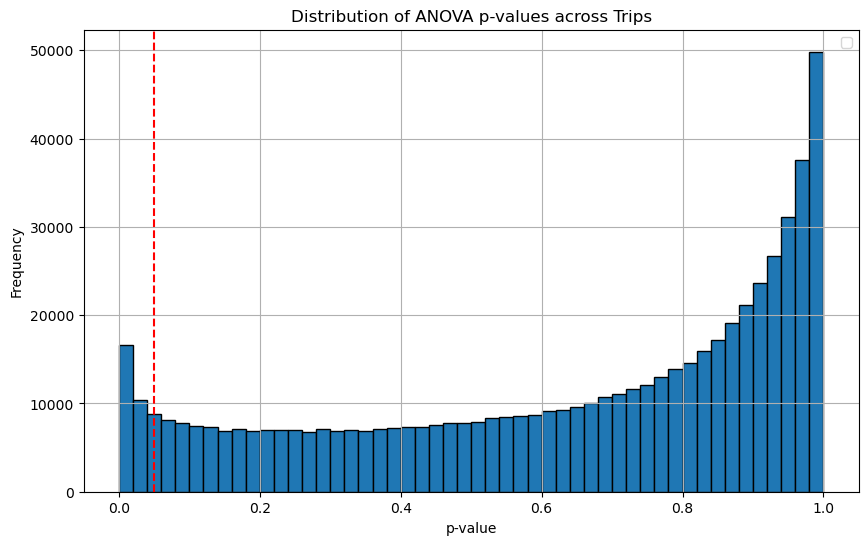

Number of edges with significant differences: 31431 out of 604172
Percentage of significant edges: 5.20%


In [ ]:
def compare_multigraph_weights_anova(g1, g2, g3):
    edge_weights1 = {}
    edge_weights2 = {}
    edge_weights3 = {}
    
    for e in g1.es:
        edge = (e.source, e.target)
        if edge not in edge_weights1:
            edge_weights1[edge] = []
        edge_weights1[edge].append(e["weight"])
        
    for e in g2.es:
        edge = (e.source, e.target)
        if edge not in edge_weights2:
            edge_weights2[edge] = []
        edge_weights2[edge].append(e["weight"])
        
    for e in g3.es:
        edge = (e.source, e.target)
        if edge not in edge_weights3:
            edge_weights3[edge] = []
        edge_weights3[edge].append(e["weight"])
    
    common_edges = set(edge_weights1.keys()) & set(edge_weights2.keys()) & set(edge_weights3.keys())
    
    p_values = []
    
    for edge in common_edges:
        weights1 = edge_weights1[edge]
        weights2 = edge_weights2[edge]
        weights3 = edge_weights3[edge]
        
        # Only if multiple observations
        if len(weights1) > 1 and len(weights2) > 1 and len(weights3) > 1:
            _, p_val = f_oneway(weights1, weights2, weights3)
            p_values.append(p_val)
                
    return p_values

# Run the analysis on the original (non-simplified) graphs
p_values = compare_multigraph_weights_anova(G_10, G_11, G_12)

plt.figure(figsize=(10, 6))
plt.hist(p_values, bins=50, edgecolor='black')
plt.axvline(x=0.05, color='r', linestyle='--')
plt.title('Distribution of ANOVA p-values across Trips')
plt.xlabel('p-value')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()

# Print summary statistics
num_significant_edges = sum(np.array(p_values) < 0.05)
total_edges = len(p_values)
print(f"Number of edges with significant differences: {num_significant_edges} out of {total_edges}")
print(f"Percentage of significant edges: {(num_significant_edges/total_edges)*100:.2f}%")
    

From this we can see that only 5.2% of the trips did change significantly between the different months. This is interesting as only a few roads out of all of the roads in Los Angeles change significantly. Now whether this actually changes the experience of the driver is a different story, but this gives an insight into the distribution of these trips. This is good news for our where-to-meet as friends living in known places wanting to meet in the same spots they have found will most likely not need to deal with seasonal changes.

# Conclusion

Now that we know *Where-to-Meet* and that we are most likely not going to be disturbed by any seasonal changes we can ensure that we can minimize how far anywone drives and meet somewhere in the middle!